# Capstone Project - The Battle of the Neighborhoods (Week 1 & 2)
## Applied Data Science Capstone by IBM/Coursera

### Week 1
#### Description of Problem
In the United Kingdom there are many places to live, many of them are full of diversity and history. As a result, it is a popular country to live in and properties are highly sought after by many people, both nationally and internationally. One of the most popular - if not the most popular - locations is within the county of Greater London. Greater London is densely populated, therefore starting any business there with an expected high foot traffic would be beneficial to that business.

Greater London is made up of 32 boroughs and 33 districts, with one of the districts being the City of London that does not identify as being a borough. Each borough has its own set of postcodes with designations as to the general location they are found in, such as E for East, NW for North West. Note that there are no S for South or NE for North East, they fold into the other postcodes.

However, not all areas of Greater London are safe to live in. Some boroughs are safer than others, so choosing to live at that location could be more hazardous. We'll use Data Science tools to look at the clustering of crime across all the Greater London boroughs and locate which borough is safest from robberies. With the safest boroughs from robberies selected, we can then work out where it would be best to start a Restaurant within that vicinity where the main venues are not restaurants.

#### Description of the data
Data will come from three locations. They are:

* Crime Data (https://data.police.uk/data/)
* Borough postcode data (e.g. for Eastern Postcodes https://en.wikipedia.org/wiki/E_postcode_area)

##### Crime Data

Data will be for crimes reported by the Metropolitan Police and City of London Police as they together cover the Greater London area. The data we'll look into would be the 2019 set of data as it is the most recent complete year.

The data files will be csv files with the following properties:

* Crime ID
* Month
* Reported by
* Falls within
* Longitude
* Latitude
* Location
* LSOA code
* LSOA name
* Crime type
* Last outcome category
* Context

The key columns are the Longitude and Latitude to use mark the locations.

##### Borough Postcode Data

Once the safest borough has been identified, the postcodes for the borough would be retrieved from Wikipedia. Postcodes would be run through geocoder to retrieve the latitudes and longitudes before passing them through the Foursquare Venue Explore API to retrieve local venues.

## Load in crime data for Greater London in 2019 and map it

In [9]:
# import libraries
import numpy as np  # useful for many scientific computing in Python
import pandas as pd # primary data structure library
import folium

print('Packages installed and imported!')

Packages installed and imported!


In [12]:
# now load file and check
df_initial = pd.read_csv("2019_Greater_London_Crimes.csv")
df_initial.head()

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,NaN,2019-01,City of London Police,City of London Police,-0.112422,51.515381,On or near Star Yard,E01000914,Camden 028B,Anti-social behaviour,NaN,NaN
1,320930473d454d613ead909a28008a91a607c93f8b7433...,2019-01,City of London Police,City of London Police,-0.112422,51.515381,On or near Star Yard,E01000914,Camden 028B,Bicycle theft,Investigation complete; no suspect identified,NaN
2,08ddf4e2aa87a1d86960d6005a2bea08f32a411939c4e3...,2019-01,City of London Police,City of London Police,-0.111497,51.518226,On or near Pedestrian Subway,E01000914,Camden 028B,Other theft,Investigation complete; no suspect identified,NaN
3,NaN,2019-01,City of London Police,City of London Police,-0.097601,51.520699,On or near Carthusian Street,E01000001,City of London 001A,Anti-social behaviour,NaN,NaN
4,NaN,2019-01,City of London Police,City of London Police,-0.095914,51.520348,On or near Beech Street,E01000001,City of London 001A,Anti-social behaviour,NaN,NaN


In [13]:
# check the crime types
df_initial['Crime type'].unique()
# we are interested in Robbery

array(['Anti-social behaviour', 'Bicycle theft', 'Other theft',
       'Criminal damage and arson', 'Drugs', 'Vehicle crime',
       'Public order', 'Robbery', 'Violence and sexual offences',
       'Other crime', 'Theft from the person', 'Burglary',
       'Possession of weapons', 'Shoplifting'], dtype=object)

In [14]:
# check shape
df_initial.shape
# that is a lot of crime

(1118074, 12)

In [18]:
# review crimes based on LSOA name (Lower Layer Super Output Areas)
df_lsoa = df_initial[['LSOA name', 'Longitude', 'Latitude', 'Crime type']]

# filter only Burglary
df_lsoa = df_lsoa[df_lsoa['Crime type'] == 'Robbery']

df_crime = df_lsoa[['LSOA name','Longitude']].groupby(['LSOA name']).count()

df_crime = df_crime.reset_index()
df_crime.columns = ['LSOA name', 'Count']
df_crime.sort_values(['Count'], ascending=False, inplace=True)
df_crime.head(20)
# so many in Westminster. Eeee...

,LSOA name,Count
4306,Westminster 018A,522
4281,Westminster 013E,514
4279,Westminster 013B,467
4308,Westminster 018C,276
1652,Hackney 027G,209
3180,Newham 013G,189
1823,Haringey 015D,179
4269,Westminster 011B,175
1861,Haringey 025A,161
4312,Westminster 019C,140


In [22]:
# quick look for curiosity sake, how many crimes were there in 2019 and how do they split?
df_list_crimes = df_initial[['Crime type','Longitude']]

df_crime_check = df_list_crimes[['Crime type','Longitude']].groupby(['Crime type']).count()
df_crime_check = df_crime_check.reset_index()
df_crime_check.columns = ['Crime type', 'Count']
df_crime_check.sort_values(['Count'], ascending=False, inplace=True)
df_crime_check.head(20)

,Crime type,Count
0,Anti-social behaviour,240953
13,Violence and sexual offences,226413
6,Other theft,124356
12,Vehicle crime,116712
2,Burglary,79315
3,Criminal damage and arson,53123
11,Theft from the person,52341
8,Public order,49655
4,Drugs,43794
10,Shoplifting,43751


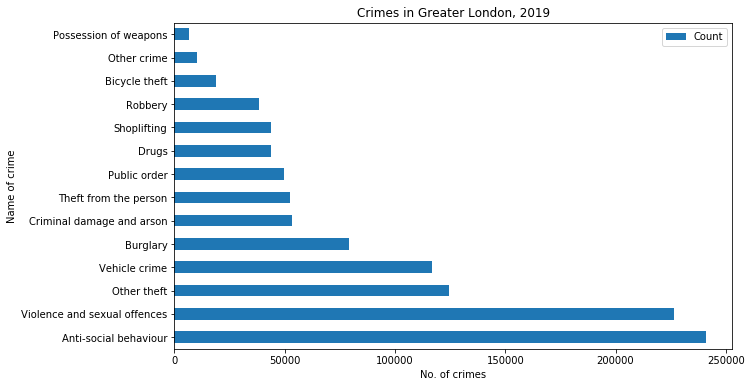

In [26]:
# plot bar graph to check crime visually
# set index first in new dataframe
df_crime_check2 = df_crime_check.set_index("Crime type")

%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

df_crime_check2.plot(kind='barh', figsize=(10, 6), rot=360) 

plt.xlabel('No. of crimes')
plt.ylabel('Name of crime')
plt.title('Crimes in Greater London, 2019')

plt.show()

In [27]:
# curiosity is over, let's do the rest
# clean up any empty longtitudes and latitudes
print(sum(pd.isnull(df_lsoa['Latitude'])))
print(sum(pd.isnull(df_lsoa['Longitude'])))
# 639 for each

# delete rows that are null
df_lsoa.dropna(how='any',axis=0, inplace=True)

print(sum(pd.isnull(df_lsoa['Latitude'])))
print(sum(pd.isnull(df_lsoa['Longitude'])))
# 0 for each now

639
639
0
0


In [28]:
# check count
df_lsoa['LSOA name'].count()
# 38435

38435

In [30]:
# there are many crimes occurring in the same location
# make them unique to minimise the numbers
df_lsoa.drop_duplicates(inplace=True)
df_lsoa['LSOA name'].count()
# much better

17251

In [31]:
# now generate map to see crime hotspots across Greater London
gl_map = folium.Map(location = [51.4309, -0.0936], zoom_start = 10)

# add markers to map
for lat, lng, lsoa in zip(df_lsoa['Latitude'], df_lsoa['Longitude'], df_lsoa['LSOA name']):
    label = '{}'.format(lsoa)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(gl_map)  

# show map
gl_map

### Greater London robberies are numerous, the safest area needs to be compared to the actual Greater London map breakdown
![Greater London Map](https://hidden-london.com/wp-content/uploads/2018/03/London-boroughs-map-742.png "Greater London Map")
#### By comparing the hotspots, it appears Richmond-upon-Thames is the safest borough for robberies.

## Next step is grabbing the postcodes for Richmond-upon-thames and obtaining the co-ordinates for them
#### Postcodes are stored here: https://en.wikipedia.org/wiki/TW_postcode_area. Will have to web scrape them out

In [32]:
from bs4 import BeautifulSoup as bs #we are going to use beauitful soup for this
import requests # we need to call the webpage

url = "https://en.wikipedia.org/wiki/TW_postcode_area"

In [33]:
# Make a GET request to fetch the raw HTML content
html_content = requests.get(url).text

# Parse the html content
soup = bs(html_content, "html")

# grab table, make sure it is the right one
gdp_table = soup.find("table", attrs={"class": "wikitable sortable"})

# grab the rows, in the table it is the <tr> tags
gdp_table_data = gdp_table.tbody.find_all("tr")

In [34]:
# get the header columns
heading = [th.text.replace("\n", " ").strip() for th in gdp_table_data[0].find_all("th")]
heading

['Postcode district', 'Post town', 'Coverage', 'Local authority area']

In [35]:
# load data into dict for dataframe
postcode = []
posttown = []
coverage = []
laa = []

print("There are " + str(len(gdp_table_data)) + " rows to process")

for i in range(1,len(gdp_table_data)):
    postcode.append(gdp_table_data[i].find_all("th")[0].text.replace("\n","").strip())
    posttown.append(gdp_table_data[i].find_all("td")[0].text.replace("\n","").strip())
    coverage.append(gdp_table_data[i].find_all("td")[1].text.replace("\n","").strip())
    laa.append(gdp_table_data[i].find_all("td")[2].text.replace("\n","").strip())
        

# add to dictionary
data = {}
data["Postal Code"] = postcode
data["Post Town"] = posttown
data["Coverage"] = coverage
data["Local authority area"] = laa

There are 21 rows to process


In [36]:
# convert to pandas dataframe
df_twpc = pd.DataFrame.from_dict(data)
df_twpc.head()

,Postal Code,Post Town,Coverage,Local authority area
0,TW1,TWICKENHAM,"Twickenham, St. Margarets, Strawberry Hill (east)","Richmond upon Thames, Hounslow"
1,TW2,TWICKENHAM,"Twickenham (west)[n 3], Whitton, Strawberry Hi...",Richmond upon Thames
2,TW3,HOUNSLOW,"Hounslow, Lampton, Whitton (north)","Hounslow, Richmond upon Thames"
3,TW4,HOUNSLOW,"Hounslow West, Hounslow Heath, Whitton (west),...","Hounslow, Richmond upon Thames"
4,TW5,HOUNSLOW,"Heston, Cranford (north), Osterley (west)",Hounslow


In [37]:
# only keep the post codes where Local authority area = Richmond upon Thames
# we don't care about the others
df_rut = df_twpc[df_twpc["Local authority area"].str.contains("Richmond upon Thames")]
df_rut

,Postal Code,Post Town,Coverage,Local authority area
0,TW1,TWICKENHAM,"Twickenham, St. Margarets, Strawberry Hill (east)","Richmond upon Thames, Hounslow"
1,TW2,TWICKENHAM,"Twickenham (west)[n 3], Whitton, Strawberry Hi...",Richmond upon Thames
2,TW3,HOUNSLOW,"Hounslow, Lampton, Whitton (north)","Hounslow, Richmond upon Thames"
3,TW4,HOUNSLOW,"Hounslow West, Hounslow Heath, Whitton (west),...","Hounslow, Richmond upon Thames"
6,TW7,ISLEWORTH,"Isleworth, Osterley (east and centre), Whitton...","Hounslow, Richmond upon Thames"
7,TW8,BRENTFORD,"Brentford, Kew Bridge, Syon Park, Brentford Ait","Hounslow, Richmond upon Thames[n 4]"
8,TW9,RICHMOND,"Richmond, Kew, North Sheen (north)",Richmond upon Thames
9,TW10,RICHMOND,"Ham, Petersham, Richmond Hill, North Sheen (so...","Richmond upon Thames, Kingston upon Thames[n 5]"
10,TW11,TEDDINGTON,"Teddington, Fulwell (east), Bushy Park",Richmond upon Thames
11,TW12,HAMPTON,"Hampton, Hampton Hill, Fulwell (west)",Richmond upon Thames


In [38]:
# now use geocoder to grab co-ordinates
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

# test first
postcode = 'HOUNSLOW, TW3'

geolocator = Nominatim(user_agent="gl_explorer")
location = geolocator.geocode(postcode)

#location
# post town, postal code

print(location[1][0]) # lat
print(location[1][1]) # long

51.4621152
-0.3621508


In [39]:
# now grab post code and co-ordinates

# columns names
column_names = ['Postal Code', 'Latitude', 'Longitude'] 

# df of co-ordinates
df_pc_and_co = pd.DataFrame(columns=column_names)

# loop, grab and apply to new df
for index, row in df_rut.iterrows():
    postalcode = row["Postal Code"]
    posttown = row["Post Town"]
    address = posttown + ", " + postalcode
    location = geolocator.geocode(address)
    pc_lon = location[1][1]
    pc_lat = location[1][0]
    df_pc_and_co = df_pc_and_co.append({'Postal Code': postalcode,
                                        'Latitude': pc_lat,
                                        'Longitude': pc_lon}, ignore_index=True)

In [40]:
# double check geo dataframe
df_pc_and_co.head()

,Postal Code,Latitude,Longitude
0,TW1,51.445506,-0.336759
1,TW2,51.446735,-0.327286
2,TW3,51.462115,-0.362151
3,TW4,51.447354,-0.382465
4,TW7,51.468356,-0.326311


In [41]:
# merge the geo dataframe and the one I created with BS
geo_merged = pd.merge(df_pc_and_co, df_rut, on='Postal Code')

#preview data
geo_merged

,Postal Code,Latitude,Longitude,Post Town,Coverage,Local authority area
0,TW1,51.445506,-0.336759,TWICKENHAM,"Twickenham, St. Margarets, Strawberry Hill (east)","Richmond upon Thames, Hounslow"
1,TW2,51.446735,-0.327286,TWICKENHAM,"Twickenham (west)[n 3], Whitton, Strawberry Hi...",Richmond upon Thames
2,TW3,51.462115,-0.362151,HOUNSLOW,"Hounslow, Lampton, Whitton (north)","Hounslow, Richmond upon Thames"
3,TW4,51.447354,-0.382465,HOUNSLOW,"Hounslow West, Hounslow Heath, Whitton (west),...","Hounslow, Richmond upon Thames"
4,TW7,51.468356,-0.326311,ISLEWORTH,"Isleworth, Osterley (east and centre), Whitton...","Hounslow, Richmond upon Thames"
5,TW8,51.486396,-0.321662,BRENTFORD,"Brentford, Kew Bridge, Syon Park, Brentford Ait","Hounslow, Richmond upon Thames[n 4]"
6,TW9,51.464290,-0.301245,RICHMOND,"Richmond, Kew, North Sheen (north)",Richmond upon Thames
7,TW10,51.461353,-0.303277,RICHMOND,"Ham, Petersham, Richmond Hill, North Sheen (so...","Richmond upon Thames, Kingston upon Thames[n 5]"
8,TW11,51.432497,-0.338649,TEDDINGTON,"Teddington, Fulwell (east), Bushy Park",Richmond upon Thames
9,TW12,51.416802,-0.370814,HAMPTON,"Hampton, Hampton Hill, Fulwell (west)",Richmond upon Thames


## Now to explore the region using Foursquare

In [42]:
# my foursquare credentials. Will be deleted before pushed onto Github
CLIENT_ID = 'RR4MHY53NKDZFUOYAOSYUYYXFCOM3IOAIFRNWKZWEMMQHNCD'
CLIENT_SECRET = 'BIHCCEY5KYU00XN4O3BEBCBIS1EJMB0ZJN1UW0AOGMLG5EAJ'
VERSION = '20180604'

In [43]:
# import extra libraries
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors

In [44]:
# prep function to get nearby venues. This was from the lab earlier so I didn't write this
# I made the radius and limit parameters
def getNearbyVenues(names, latitudes, longitudes, r, l):
    radius=r
    limit=l
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            limit)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
    
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Postal Code', 
                  'Postal Code Latitude', 
                  'Postal Code Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [45]:
# grab the venues near those post codes
# radius 500m and limit 100
rut_venues = getNearbyVenues(names=geo_merged['Postal Code'],
                             latitudes=geo_merged['Latitude'],
                             longitudes=geo_merged['Longitude'],
                             r=500,
                             l=100)

TW1
TW2
TW3
TW4
TW7
TW8
TW9
TW10
TW11
TW12
TW13
TW16


In [46]:
rut_venues.head()

,Postal Code,Postal Code Latitude,Postal Code Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TW1,51.445506,-0.336759,Ruben's Bakehouse,51.445268,-0.332340,Bakery
1,TW1,51.445506,-0.336759,Twickenham Green,51.444150,-0.342485,Park
2,TW1,51.445506,-0.336759,ASK Italian,51.444516,-0.342192,Italian Restaurant
3,TW1,51.445506,-0.336759,TW2 Bar & Grill,51.444154,-0.343013,Restaurant
4,TW1,51.445506,-0.336759,The Three Kings,51.445413,-0.331828,Pub


In [47]:
# check how many venues were returned
rut_venues.groupby('Postal Code').count()

,Postal Code Latitude,Postal Code Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Postal Code,,,,,,
TW1,13,13,13,13,13,13
TW10,100,100,100,100,100,100
TW11,4,4,4,4,4,4
TW12,6,6,6,6,6,6
TW13,17,17,17,17,17,17
TW16,5,5,5,5,5,5
TW2,52,52,52,52,52,52
TW3,9,9,9,9,9,9
TW4,4,4,4,4,4,4


In [48]:
# now check how many unique venues there are
print('There are {} uniques categories.'.format(len(rut_venues['Venue Category'].unique())))

There are 80 uniques categories.


In [49]:
# one hot encoding
richmond_onehot = pd.get_dummies(rut_venues[['Venue Category']], prefix="", prefix_sep="")
#richmond_onehot.drop(['Postal Code'],axis=1,inplace=True) 
richmond_onehot.insert(loc=0, column='Postal Code', value=rut_venues['Postal Code'] )
richmond_onehot

,Postal Code,American Restaurant,Antique Shop,Argentinian Restaurant,Arts & Entertainment,Asian Restaurant,Athletics & Sports,BBQ Joint,Bakery,Bar,...,Stationery Store,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Train Station,Vietnamese Restaurant,Waterfront
0,TW1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,TW1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,TW1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,TW1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,TW1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
301,TW16,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
302,TW16,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
303,TW16,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
304,TW16,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [50]:
# check shape
richmond_onehot.shape

(306, 81)

In [51]:
# group the data for richmond upon thames
richmond_grouped = richmond_onehot.groupby('Postal Code').mean().reset_index()

In [52]:
# preview the group data
richmond_grouped

,Postal Code,American Restaurant,Antique Shop,Argentinian Restaurant,Arts & Entertainment,Asian Restaurant,Athletics & Sports,BBQ Joint,Bakery,Bar,...,Stationery Store,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Thai Restaurant,Theater,Train Station,Vietnamese Restaurant,Waterfront
0,TW1,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.076923,0.00,...,0.000000,0.000000,0.076923,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00
1,TW10,0.010000,0.0,0.010000,0.000000,0.010000,0.000000,0.000000,0.040000,0.02,...,0.010000,0.000000,0.010000,0.020000,0.01,0.010000,0.020000,0.010000,0.000000,0.01
2,TW11,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00
3,TW12,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.166667,0.000000,0.00
4,TW13,0.058824,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.117647,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00
5,TW16,0.000000,0.2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.200000,0.000000,0.00
6,TW2,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.019231,0.019231,0.00,...,0.019231,0.019231,0.019231,0.000000,0.00,0.000000,0.000000,0.000000,0.019231,0.00
7,TW3,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00
8,TW4,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00
9,TW7,0.000000,0.0,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.00,...,0.000000,0.000000,0.000000,0.083333,0.00,0.000000,0.000000,0.000000,0.000000,0.00


In [53]:
# now view each postal codes' top 5 venues one after the other in Richmond upon Thames
num_top_venues = 5

for postcode in richmond_grouped['Postal Code']:
    print("----"+postcode+"----")
    temp = richmond_grouped[richmond_grouped['Postal Code'] == postcode].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----TW1----
                   venue  freq
0          Grocery Store  0.15
1                   Park  0.08
2  Portuguese Restaurant  0.08
3     Italian Restaurant  0.08
4                    Pub  0.08


----TW10----
                venue  freq
0                 Pub  0.14
1                Café  0.09
2  Italian Restaurant  0.06
3         Coffee Shop  0.05
4          Restaurant  0.04


----TW11----
                      venue  freq
0               Pizza Place  0.25
1      Gym / Fitness Center  0.25
2                       Pub  0.25
3        Italian Restaurant  0.25
4  Mediterranean Restaurant  0.00


----TW12----
           venue  freq
0  Grocery Store  0.33
1    Pizza Place  0.17
2  Train Station  0.17
3           Café  0.17
4           Park  0.17


----TW13----
            venue  freq
0  Clothing Store  0.12
1     Supermarket  0.12
2        Pharmacy  0.12
3  Sandwich Place  0.06
4       Gift Shop  0.06


----TW16----
                  venue  freq
0          Antique Shop   0.2
1         Tra

In [54]:
# function to return most common venues, allowing to pass the top n venues to return
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Postal Code']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe for venues
venues_sorted = pd.DataFrame(columns=columns)
venues_sorted['Postal Code'] = richmond_grouped['Postal Code']

for ind in np.arange(richmond_grouped.shape[0]):
    venues_sorted.iloc[ind, 1:] = return_most_common_venues(richmond_grouped.iloc[ind, :], num_top_venues)

In [55]:
# preview venues to get a better view as the top 5 view was too long, we need a grid
venues_sorted

,Postal Code,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,TW1,Grocery Store,Fish Market,Pub,Park,Café,Farmers Market,Supermarket,Pizza Place,Bakery,Portuguese Restaurant
1,TW10,Pub,Café,Italian Restaurant,Coffee Shop,Restaurant,Bakery,Grocery Store,Burger Joint,French Restaurant,Theater
2,TW11,Pizza Place,Gym / Fitness Center,Pub,Italian Restaurant,Fish & Chips Shop,Deli / Bodega,Cocktail Bar,Coffee Shop,Comic Shop,French Restaurant
3,TW12,Grocery Store,Pizza Place,Train Station,Park,Café,Dessert Shop,Cocktail Bar,Coffee Shop,Comic Shop,Convenience Store
4,TW13,Clothing Store,Supermarket,Pharmacy,Gift Shop,Sandwich Place,Discount Store,Hotel,Memorial Site,Mexican Restaurant,Movie Theater
5,TW16,Train Station,Antique Shop,Gym / Fitness Center,Hotel,Racecourse,Waterfront,Discount Store,Coffee Shop,Comic Shop,Convenience Store
6,TW2,Pub,Coffee Shop,Italian Restaurant,Bus Stop,Sandwich Place,Pizza Place,Pharmacy,Indian Restaurant,Café,Grocery Store
7,TW3,Indian Restaurant,Chinese Restaurant,Bus Stop,Pub,Convenience Store,Clothing Store,Electronics Store,Chocolate Shop,Farmers Market,English Restaurant
8,TW4,Chinese Restaurant,Café,Pub,Convenience Store,Dessert Shop,Cocktail Bar,Coffee Shop,Comic Shop,Cycle Studio,Deli / Bodega
9,TW7,Pub,Chinese Restaurant,Pharmacy,Coffee Shop,Memorial Site,Asian Restaurant,Sushi Restaurant,Grocery Store,Gym / Fitness Center,Breakfast Spot


## Looks good so far, now generate a cluster map to view distribution of venues

In [56]:
# prep before mapping
# set number of clusters
kclusters = 5

# remove Postal Code as it is categorical data and won't mean much to the k-means algorithm
richmond_gclust = richmond_grouped.drop('Postal Code', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(richmond_gclust)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

# add clustering labels
venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

richmond_merged = geo_merged

# merge richmond_grouped with richmond_data, adding latitude/longitude for each postal code
richmond_merged = richmond_merged.join(venues_sorted.set_index('Postal Code'), on='Postal Code')

# co=ordinates for Richmond upon Thames
latitude = 51.4613
longitude = -0.3037

# as taken from the lab, but edited slightly
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(richmond_merged['Latitude'], richmond_merged['Longitude'], richmond_merged['Postal Code'], richmond_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)

# show map
map_clusters

In [57]:
# interesting, let's examine the clusters as Cluster 0 takes up the most sections
# Cluster 1
richmond_merged.loc[richmond_merged['Cluster Labels'] == 0, richmond_merged.columns[[1] + list(range(5, richmond_merged.shape[1]))]]

,Latitude,Local authority area,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,51.445506,"Richmond upon Thames, Hounslow",0,Grocery Store,Fish Market,Pub,Park,Café,Farmers Market,Supermarket,Pizza Place,Bakery,Portuguese Restaurant
1,51.446735,Richmond upon Thames,0,Pub,Coffee Shop,Italian Restaurant,Bus Stop,Sandwich Place,Pizza Place,Pharmacy,Indian Restaurant,Café,Grocery Store
2,51.462115,"Hounslow, Richmond upon Thames",0,Indian Restaurant,Chinese Restaurant,Bus Stop,Pub,Convenience Store,Clothing Store,Electronics Store,Chocolate Shop,Farmers Market,English Restaurant
4,51.468356,"Hounslow, Richmond upon Thames",0,Pub,Chinese Restaurant,Pharmacy,Coffee Shop,Memorial Site,Asian Restaurant,Sushi Restaurant,Grocery Store,Gym / Fitness Center,Breakfast Spot
5,51.486396,"Hounslow, Richmond upon Thames[n 4]",0,Coffee Shop,Gym,Deli / Bodega,Pizza Place,Sandwich Place,Movie Theater,Furniture / Home Store,BBQ Joint,Electronics Store,Comic Shop
6,51.464290,Richmond upon Thames,0,Pub,Coffee Shop,Italian Restaurant,Grocery Store,Bakery,Restaurant,Café,Theater,Train Station,Sushi Restaurant
7,51.461353,"Richmond upon Thames, Kingston upon Thames[n 5]",0,Pub,Café,Italian Restaurant,Coffee Shop,Restaurant,Bakery,Grocery Store,Burger Joint,French Restaurant,Theater
10,51.446934,"Hounslow, Richmond upon Thames",0,Clothing Store,Supermarket,Pharmacy,Gift Shop,Sandwich Place,Discount Store,Hotel,Memorial Site,Mexican Restaurant,Movie Theater


In [58]:
# Cluster 2
richmond_merged.loc[richmond_merged['Cluster Labels'] == 1, richmond_merged.columns[[1] + list(range(5, richmond_merged.shape[1]))]]

,Latitude,Local authority area,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
9,51.416802,Richmond upon Thames,1,Grocery Store,Pizza Place,Train Station,Park,Café,Dessert Shop,Cocktail Bar,Coffee Shop,Comic Shop,Convenience Store


In [59]:
# Cluster 3
richmond_merged.loc[richmond_merged['Cluster Labels'] == 2, richmond_merged.columns[[1] + list(range(5, richmond_merged.shape[1]))]]

,Latitude,Local authority area,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
11,51.417966,"Spelthorne, Elmbridge[n 6], Richmond upon Tham...",2,Train Station,Antique Shop,Gym / Fitness Center,Hotel,Racecourse,Waterfront,Discount Store,Coffee Shop,Comic Shop,Convenience Store


In [60]:
# Cluster 4
richmond_merged.loc[richmond_merged['Cluster Labels'] == 3, richmond_merged.columns[[1] + list(range(5, richmond_merged.shape[1]))]]

,Latitude,Local authority area,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,51.447354,"Hounslow, Richmond upon Thames",3,Chinese Restaurant,Café,Pub,Convenience Store,Dessert Shop,Cocktail Bar,Coffee Shop,Comic Shop,Cycle Studio,Deli / Bodega


In [61]:
# Cluster 5
richmond_merged.loc[richmond_merged['Cluster Labels'] == 4, richmond_merged.columns[[1] + list(range(5, richmond_merged.shape[1]))]]

,Latitude,Local authority area,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
8,51.432497,Richmond upon Thames,4,Pizza Place,Gym / Fitness Center,Pub,Italian Restaurant,Fish & Chips Shop,Deli / Bodega,Cocktail Bar,Coffee Shop,Comic Shop,French Restaurant
